# Assignment #4 - Reinforcement Learning 


### Saloni Gupta


## I. Overview

Reinforcement Learning(RL) is a type of machine learning technique that enables an agent to learn in an interactive environment by trial and error using feedback from its own actions and experiences. Both supervised and reinforcement learning use mapping between input and output. But supervised learning is where feedback provided to the agent is correct set of actions for performing a task while reinforcement learning uses rewards and punishment as signals for positive and negative behavior. As compared to unsupervised learning, reinforcement learning is different in terms of goals. While the goal in unsupervised learning is to find similarities and differences between data points, in reinforcement learning the goal is to find a suitable action model that would maximize the total cumulative reward of the agent.

In our assignment 4, we will be using our knowledge of reinforcement learning to design a RLAgent to play Blackjack game.  Blackjack is a game of cards where any number of players can be involved in the game against a dealer and the aim is to obtain a sum of cards equal to or less than 21. If the player gets cards whose sum is greater than 21, the player is busted. We have been given an option to implement either Q-learning or SARSA for the assignment. Also towards the end we are asked to implement the maze agent and test it against different maze input sizes and for that we will be using the codes provided by the professor in the class notes. 

Firstly for this task, I have used SARSA learning to train the model. The major benefit that SARSA serves is thta it does not require to explore all the states in order to find a solution while Q-learning requires us to explore all the states which can be time consuming.



## II. Problems

### Blackjack

Blackjack is a card game which is played with the goal to get a sum of cards equal to or less than 21 without going over. There can be any number of players playing against a single dealer. In our game, face cards have point value of 10. Aces can either count as 11 or 1, and it's called 'usable' at 11. This game is placed with an infinite deck. 

The game starts with each player getting two face up cards and dealer having one face up and face down card and the player needs to bet an amount of money within range of 1 to max bet (10). Note: Face up means that you will know what the card is.
The player can request additional cards (hit=1) until they decide to stop (stick=0) or exceed 21 (bust). After the player sticks, the dealer reveals their facedown card, and draws until their sum is 17 or greater (fixed policy). If the dealer goes bust the player wins. You won't see the dealer's facedown card, just you will know if you have or lost and you will get appropriate reward of +1 if you win, -1 if you loose or 0 if the match is drawn. (It is freedom of choice for you to change the reward function. If you want to change, you should explain the reason of the change.)

If the player wins, the amount he has bet will be doubled and given back. If the player and dealer have the same sum, then its a draw and the player will get back the money he has bet. If the player loses then, the money he bet will be lost. If neither player nor dealer busts, the outcome (win, lose, draw) is decided by whose sum is closer to 21. You are free to change the reward function to make it learn more efficiently. (i.e., the amount of money the user is winning after each round).

## Methods

### SARSA

State–action–reward–state–action (SARSA) is an algorithm for learning a Markov decision process policy, used in the reinforcement learning area of machine learning. A SARSA agent interacts with the environment and updates the policy based on actions taken, hence this is known as an on-policy learning algorithm. The Q value for a state-action is updated by an error, adjusted by the learning rate alpha. Q values represent the possible reward received in the next time step for taking action a in state s, plus the discounted future reward received from the next state-action observation.

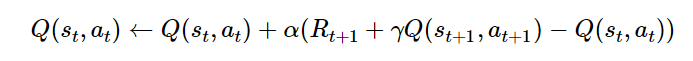
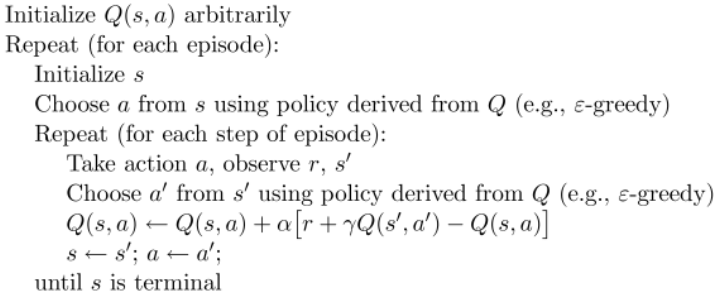


### Q-learning

Q-learning is a model-free reinforcement learning algorithm. The goal of Q-learning is to learn a policy, which tells an agent what action to take under what circumstances. It does not require a model (hence the connotation "model-free") of the environment, and it can handle problems with stochastic transitions and rewards, without requiring adaptations. For any finite Markov decision process (FMDP), Q-learning finds a policy that is optimal in the sense that it maximizes the expected value of the total reward over any and all successive steps, starting from the current state. Q-learning can identify an optimal action-selection policy for any given FMDP, given infinite exploration time and a partly-random policy. "Q" names the function that returns the reward used to provide the reinforcement and can be said to stand for the "quality" of an action taken in a given state.

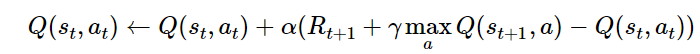
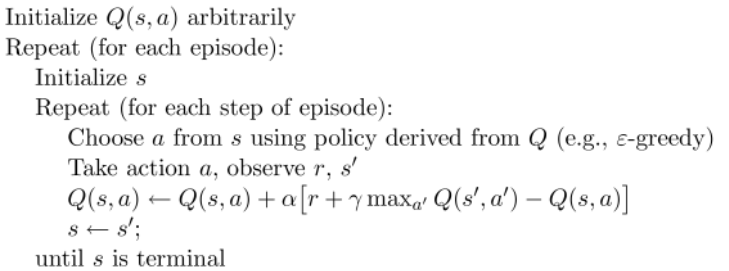

### Choice of TD learning and Reason

#### Temporal Difference:

Temporal difference (TD) learning refers to a class of model-free reinforcement learning methods which learn by bootstrapping from the current estimate of the value function. These methods sample from the environment, like Monte Carlo methods, and perform updates based on current estimates, like dynamic programming methods. While Monte Carlo methods only adjust their estimates once the final outcome is known, TD methods adjust predictions to match later, more accurate, predictions about the future before the final outcome is known. 

#### Choice of Temporal Difference Learning Approach:

##### Q-learning: 

This assignment requires us to select one of the two approaches, that is, SARSA or Q-learning. 
SARSA uses its current policy and Q-value of the next state to update the Q-value of a given state. This makes it "on-policy" learning whereas Q-learning uses an epsilon-greedy policy and Q-value of the next state to update the Q-value of a given state. This makes it "off-poicy" learning.

For this assignment, I choose to use Q-learning because then my model can explore all possible states to select the most optimal path by exploring all the paths. I chose to use Q-learning because it has the ability to find the optimal path independent of the policy used in traversing and updating the Q-values of the states. Thus, this will help me find an optimal path instead of a near optimal path.



### Choice of Function Approximation and Reason

Q-learning can be combined with function approximation as it makes it possible to apply the algorithms to larger problems even when the state space is continuous. I am using Q-table as my function approximator. It is basically a lookup table where we calculate the maximum expected future rewards for action at each state. So, basically it will guide us to the best action at each state. We are using q-table because it works as a reference table for our agent to select the best action based on the q-value. I would have opted for neural network as function approximator, but due to limited time I could not implement that. Hence I am using Q-table as my approximator.


### Implementation of RLAgent


In [1]:
import collections
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import clear_output
import gym
from gym import spaces
from gym.utils import seeding
%matplotlib inline
import random

In [2]:
class Player():
    """
        
        Player class to create a player object.
        eg: player = Player("player1", start_balance = 10)
        Above declaration will be for your agent.
        All the player names should be unique or else you will get error.
        
    """
    def __init__(self, player_name, start_balance = 10):
        self.player_name = player_name
        self.card = []
        self.starter_balance = start_balance
        self.total_balance = start_balance

    def recharge_account(self):
        self.total_balance = self.starter_balance
        
    def get_info(self):
        print("Player name: {}".format(self.player_name))
        print("Player card: {}".format(self.card))
        print("Player total_balance: {}".format(self.total_balance))  

In [3]:
# 1 = Ace, 2-10 = Number cards, Jack/Queen/King = 10
deck = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 10, 10, 10]

def cmp(a, b):
    return float(a > b) - float(a < b)


def draw_card(np_random):
    return int(np_random.choice(deck))


def draw_hand(np_random):
    return [draw_card(np_random), draw_card(np_random)]


def usable_ace(hand):  # Does this hand have a usable ace?
    return 1 in hand and sum(hand) + 10 <= 21


def sum_hand(hand):  # Return current hand total
    if usable_ace(hand):
        return sum(hand) + 10
    return sum(hand)


def is_bust(hand):  # Is this hand a bust?
    return sum_hand(hand) > 21


def score(hand):  # What is the score of this hand (0 if bust)
    return 0 if is_bust(hand) else sum_hand(hand)


def is_natural(hand):  # Is this hand a natural blackjack?
    return sorted(hand) == [1, 10]



In [4]:
class BlackjackEnv(gym.Env):
    """
    Simple blackjack environment
    
    Blackjack is a card game where the goal is to obtain cards that sum to as
    near as possible to 21 without going over.  They're playing against a fixed
    dealer.
    Face cards (Jack, Queen, King) have point value 10.
    Aces can either count as 11 or 1, and it's called 'usable' at 11.
    This game is placed with an infinite deck (or with replacement).
    The game starts with each (player and dealer) having one face up and one
    face down card.
    The player can request additional cards (hit=1) until they decide to stop
    (stick=0) or exceed 21 (bust).
    After the player sticks, the dealer reveals their facedown card, and draws
    until their sum is 17 or greater.  If the dealer goes bust the player wins.
    If neither player nor dealer busts, the outcome (win, lose, draw) is
    decided by whose sum is closer to 21.  The reward for winning is +1,
    drawing is 0, and losing is -1.
    The observation is: the players current sum, players current card, players balance left, 
    the dealer's one showing card (1-10 where 1 is ace),
    and whether or not the player holds a usable ace (0 or 1).
    
    Parameters
    ==========
    natural      boolean
                 option for 50% more reward on natural blackjack 
    
    """
    
    def __init__(self, natural=False):
        self.action_space = spaces.Discrete(2)
        self.observation_space = spaces.Tuple((
            spaces.Discrete(32),
            spaces.Discrete(11),
            spaces.Discrete(2)))
        self.seed()
        self.total_players = 1
        self.players = {}
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}
        self.max_bet_cap = 10

    def add_player(self, player_class):
        if player_class not in self.players and len(self.players) < self.total_players:
            self.players[player_class.player_name] = player_class
        else:
            raise Exception("Maximum number of player allowed: {}. You can increase the player count while initializing the environment".format(len(self.players)))

    def seed(self, seed=None):
        self.np_random, seed = seeding.np_random(seed)
        return [seed]

    def step(self, player_name, action):
        assert self.action_space.contains(action)
        if action:  # hit: add a card to players hand and return
            self.players[player_name].card.append(draw_card(self.np_random))
            if is_bust(self.players[player_name].card):
                done = True
                reward = -1
            else:
                done = False
                reward = 0
        else:  # stick: play out the dealers hand, and score
            done = True
            while sum_hand(self.dealer) < 17:
                self.dealer.append(draw_card(self.np_random))
            reward = cmp(score(self.players[player_name].card), score(self.dealer))
            if self.natural and is_natural(self.players[player_name].card) and reward == 1:
                reward = 1.5
        if done:
            self.settle_balance(int(reward), player_name)
        return {'state':self._get_obs(player_name), 'reward': reward, 'is_round_done': done}

    def _get_obs(self, player_name):
        return {'player_info':self.get_player_obs(player_name), 
                'dealer_info': self.dealer[0]}

    def get_player_obs(self, player_name):
        return {'player_sum_card':sum_hand(self.players[player_name].card), 
                'player_card':self.players[player_name].card, 
                'player_total_balance':self.players[player_name].total_balance, 
                'usable_ace' : usable_ace(self.players[player_name].card)}
    
    def get_valid_bet_amount(self, player_name):
        print("player name: {} money left: {}".format(player_name, self.players[player_name].total_balance))
        if self.players[player_name].total_balance < 1:
            return {'is_round_done': True, 'valid_bet_amount': -1}
        max_bet_upper_limit = self.players[player_name].total_balance
        if self.players[player_name].total_balance >= self.max_bet_cap:
            max_bet_upper_limit = self.max_bet_cap            
        return {'is_round_done': False, 'valid_bet_amount': list(range(1, max_bet_upper_limit+1))}
            
    def init_round(self, player_name):         
        self.dealer = draw_hand(self.np_random)
        self.players[player_name].card = draw_hand(self.np_random)
        return {'state': self._get_obs(player_name)}        

    def bet_money(self, player_name, bet_amount):
        self.players[player_name].total_balance -= bet_amount
        self.round_bet_info[player_name] = bet_amount
            
    def settle_balance(self, is_winner, player_name):
        if is_winner == 1:
            print("player winner")
            self.players[player_name].total_balance += (2 * self.round_bet_info[player_name])
        elif is_winner == 0:
            print("Draw match")
            self.players[player_name].total_balance += self.round_bet_info[player_name]
        else:
            print("player loser, wont get back the money, try next round")
    
    def reset(self, natural=False):
        for player_name, player_class in self.players.items():
            player_class.recharge_account()
        self.natural = natural
        self.dealer = []
        self.round_bet_info = {}


The Blackjack game environment is defined as follows. Inheriting, OpenAI.Gym.Env, it overrides the interfances to enable the interfaction with the same interfaces with other OpenAI Gym environments.

These are important member functions to be used by you:

* add_player: You can add your player object with some initial amount of money

* step: you need to send the action using this function, actions are hit(1) or stand(0)

 returns {'state': player info and dealer info (_get_obs), 
          'reward': real-valued reward, 
          'is_round_done': True/Fasle}
* _get_obs: returns the state of the env or required information you can use to build your agent.
      eg: {'player_info':{'player_sum_card': sum of cards, 
                          'player_card': list of cards, 
                          'player_total_balance': real-valued number, 
                          'usable_ace' : True/False}, 
          'dealer_info': dealer's first card}
* init_round: will start a new round in the same game.

 returns {'state': player info and dealer info (_get_obs)}
* reset: will reset the whole game and you will being again with the initial balance you had started the player object.

 returns nothing, will just reset the entire game.
* bet_money: you can bet the amount using this method, takes in the money between (1, max_bet_cap). max_bet_cap is 10.

 returns nothing.

All the above classes have been provided to us by the professor in the assignment. We have one class with player information and one which sets up the blackjack environment. Using these classes I will be further building an RLAgent class.

In [5]:
class RLAgent: 
    
    def __init__(self, evn):
        self.env = env
        #self.size = env.get_size()
        #self.n_a = len(env.get_actions())
        # self.Q table including the surrounding border
        self.Q = np.random.rand(32, 11, 2, 2) # values come from the discrete spaces provided in the BlackjackEnv
        
    
    # selects greedy action
    def greedy(self, Q, s, env):
        act = [0,1]  #0 = stand, 1 = hit
        flag = True
        x = Q[s[0]][s[1]][s[2]] 
        while flag:
            if np.argmax(x) in act:
                action = np.argmax(x)     #if an action gives maximum then set that action
                flag = False
            else:
                x = np.delete(x,np.argmax(x))   #else delete that action
                flag = True
                
        return action
        
        
    def epsilon_greed(self, epsilon, s, env):
        if np.random.rand() < epsilon:
            a = [0,1]
            return random.choice(a)
        else:
            return self.greedy(self.Q, s, env)
        
    
    def train(self, start, **params):
        
        self.blackjack = BlackjackEnv()    #object of BlackjackEnv class
        
        # parameters
        gamma = params.pop('gamma')
        alpha = params.pop('alpha')
        self.epsilon= params.pop('epsilon')
        maxiter= params.pop('maxiter', 500) 
        maxstep= params.pop('maxstep', 50)
        
        # online train
        # rewards and step trace
        rtrace = []
        steps = []
        self.action = []
        
        p = Player("Saloni",10)       #object of Player class
        self.blackjack.add_player(p)
        
        for i in range(maxiter):
            rewards = []
            self.blackjack.reset()
            self.blackjack.init_round(p.player_name)
            #clear_output()
            
            for j in range(maxstep):
                print("*-* " * 20)
                self.blackjack.init_round(p.player_name)
                valid_bet_flag = self.blackjack.get_valid_bet_amount(p.player_name)
                
                if valid_bet_flag['is_round_done']:
                    print("You are out of money ! Will go to next game !!")
                    break
                bet_amount = valid_bet_flag['valid_bet_amount']

                # If you have just $1 left in the bank, you have no choice but to bet that amount 
                # and hopefully leave it to the fate for your agent to win and continue playing or just
                # start a new game
                if len(bet_amount) == 1 and bet_amount[0] == 1:
                    print("You can only bet 1. So betting only 1.")
                    random_bet = 1
                else:
                    random_bet = np.random.choice(bet_amount)
                    
                print("Bet: {}".format(random_bet))
                self.blackjack.bet_money(p.player_name, random_bet)
                player_sum = self.blackjack.get_player_obs(p.player_name)['player_sum_card']   #get sum of player's cards
                dealer_sum = self.blackjack._get_obs(p.player_name)['dealer_info']         #get sum of dealer's cards
                usable_sum = self.blackjack.get_player_obs(p.player_name)['usable_ace']    #get sum of usable ace
                state = np.array([int(player_sum), int(dealer_sum), int(usable_sum)])
                a_greed = self.epsilon_greed(self.epsilon, state, self.blackjack)
                step1 = self.blackjack.step("Saloni", self.epsilon_greed(self.epsilon, state, self.blackjack))
            
                
                if step1['is_round_done']:
                    current_balance = self.blackjack.get_player_obs(p.player_name)['player_total_balance']
                    print("Current Balance : " + str(current_balance))
                    player_sum = self.blackjack.get_player_obs(p.player_name)['player_sum_card']
                    dealer_sum = self.blackjack._get_obs(p.player_name)['dealer_info']
                    usable_sum = self.blackjack.get_player_obs(p.player_name)['usable_ace']
                    state1 = np.array([int(player_sum), int(dealer_sum), int(usable_sum)])
                     
                    result = int(step1['reward'])
                    rewards.append(result)
                    self.Q[state[0]][state[1]][state[2]][a_greed] = self.Q[state[0]][state[1]][state[2]][a_greed]+alpha*(result+(gamma*max(self.Q[state1[0]][state1[1]][state1[2]]))-self.Q[state[0]][state[1]][state[2]][a_greed])
                    continue
                    
                while not step1['is_round_done']:
                    current_balance = self.blackjack.get_player_obs(p.player_name)['player_total_balance']
                    print("Current Balance : " + str(current_balance))
                    player_sum = self.blackjack.get_player_obs(p.player_name)['player_sum_card']
                    dealer_sum = self.blackjack._get_obs(p.player_name)['dealer_info']
                    usable_sum = self.blackjack.get_player_obs(p.player_name)['usable_ace']
                    state = np.array([int(player_sum), int(dealer_sum), int(usable_sum)])
                    a_greed = self.epsilon_greed(self.epsilon, state, self.blackjack)
                   
                    step1 = self.blackjack.step("Saloni", a_greed)
                    
                    result = int(step1['reward'])
                    
                    player_sum = self.blackjack.get_player_obs(p.player_name)['player_sum_card']
                    dealer_sum = self.blackjack._get_obs(p.player_name)['dealer_info']
                    usable_sum = self.blackjack.get_player_obs(p.player_name)['usable_ace']
                    state1 = np.array([int(player_sum), int(dealer_sum), int(usable_sum)])
                    a1_greed = self.epsilon_greed(self.epsilon, state1, self.blackjack)
                    
                rewards.append(result)
                self.Q[state[0]][state[1]][state[2]][a_greed] = self.Q[state[0]][state[1]][state[2]][a_greed]+alpha*(result+(gamma*max(self.Q[state1[0]][state1[1]][state1[2]]))-self.Q[state[0]][state[1]][state[2]][a_greed])
                continue
            rtrace.append(np.sum(rewards))
        return rtrace,self.Q,rewards
        
        

    def test(self):
        self.blackjack = BlackjackEnv()
        win = 0
        loss = 0
        maxstep = 1000
        ptest = Player("Saloni",10)
        self.blackjack.add_player(ptest)

        for i in range(1):
            self.blackjack.reset()
            for j in  range(50):
                print("*-* "* 20)
                print("Round Number : ", j)
                self.blackjack.init_round(ptest.player_name)
                
                
                valid_bet_flag = self.blackjack.get_valid_bet_amount(ptest.player_name)
                if valid_bet_flag['is_round_done']:
                    print("You are out of money ! Will go to next game !!")
                    break
                bet_amount = valid_bet_flag['valid_bet_amount']

                # If you have just $1 left in the bank, you have no choice but to bet that amount 
                # and hopefully leave it to the fate for your agent to win and continue playing or just
                # start a new game
                if len(bet_amount) == 1 and bet_amount[0] == 1:
                    print("You can only bet 1. So betting only 1.")
                    random_bet = 1
                else:
                    #random_bet = np.random.choice(bet_amount)
                    random_bet=1
                    
                print("Bet amount : {}".format(random_bet))
                self.blackjack.bet_money(ptest.player_name, random_bet)
                player_sum = self.blackjack.get_player_obs(ptest.player_name)['player_sum_card']
                dealer_sum = self.blackjack._get_obs(ptest.player_name)['dealer_info']
                usable_sum = self.blackjack.get_player_obs(ptest.player_name)['usable_ace']
                state = np.array([int(player_sum), int(dealer_sum), int(usable_sum)])
                a_greed = self.epsilon_greed(self.epsilon, state, self.blackjack)
                step1 = self.blackjack.step("Saloni", a_greed)

                
                self.action.append(a_greed)
                result = step1['reward']
                
                if result>0:
                    win += 1
                elif result<0:
                    loss += 1
                
                
                while not step1['is_round_done']:
                    current_balance = self.blackjack.get_player_obs(ptest.player_name)['player_total_balance']
                    print("Current Balance : ", str(current_balance))
                    player_sum = self.blackjack.get_player_obs(ptest.player_name)['player_sum_card']
                    dealer_sum = self.blackjack._get_obs(ptest.player_name)['dealer_info']
                    usable_sum = self.blackjack.get_player_obs(ptest.player_name)['usable_ace']
                    state = np.array([int(player_sum), int(dealer_sum), int(usable_sum)])
                    a_greed = self.epsilon_greed(self.epsilon, state, self.blackjack)

                    
                    step1 = self.blackjack.step("Saloni", a_greed)
                    result = int(step1['reward'])
                    if result>0:
                        win += 1
                    elif result<0:
                        loss += 1
                    
                    print("result: {}".format(step1))
        return win,loss
                
    

#### Code Explanation


* init(): In this method, we initialize Q-table which has four dimensions provided byt he professor. The dimensions are, player's card sum(32), dealer's sum with one card face-up(11), usable ace(2) and actions(2)


* greedy(): It takes as input the environment, state(s) and Q which is the q-table. It works by getting available actions fromt he player and selects the greedy action from that list of available actions. So, it checks if np.argmax(x) is present or not in the list of available actions. If it is present then it will selec the action as it will give the ebst greedy result else it will delete the action from the q-table. This loop thus continues to select the greddy action based on the argmax(x) condition.


* epsilon_greed(): It takes as input, the state(s), environment and epsilon. It checks the condition np.random.rand() < epsilon and based on it, it assigns action to the player. We are therefore, generating random number to then perform exploitation or exploration based on the np.random.rand() < epsilon condition.


* train(): It takes as input the start and parameters. Parameters are epsilon, alpha, gamma, maxiter and maxstep. We initialize the empty lists, rtrace, steps and action. rtrace will be used for appending sum of rewards after each iteration. Then we use two for loops, one for maxiter and then for maxstep. Maxiter defines the number of games being played and maxstep being the number of rounds being played. Inside the for loop, we will reset the environment to initiate each round. Also, we have created an object of class Player. Using the functions provided by the professor, get_player_obs we use for getting the sum of player's cards, _get_obs gives us the dealer's card and then we check if the ace is usable or not. Then we check if the account has enough money to bet or not. If it doesn't have sufficient balance then we break it and start a new game. my agent will decide to reward +1 when a good exploration is performed else it gives -1 reward. If the sum of cards is 21, the bot is rewarded with 1.5. Reward is then updated in the blackjack environment. Thus, it keeps on performing greedy action to get more rewards. While betting if the agent has 1 dollar, it will bet 1 else use np.random.choice(bet_amount) to get a random bet. Further we are calling the step function. If the is 'is_round_done' then we get current state and reward. Using formula    self.Q[state[0]][state[1]][state[2]][a_greed] = self.Q[state[0]][state[1]][state[2]][a_greed]+alpha*(result+(gamma*(self.Q[state1[0]][state1[1]][state1[2]]))-self.Q[state[0]][state[1]][state[2]][a_greed]). 
If while not step1['is_round_done'] is true then we fetch states from the environmentand select a greedy action based on epsilon value else we select a random action. The result is then changed based on the reward and at the end the rtrace is appended with the rewards.



* test(): While training, we select greedy action for each turn without updating the q-table. Bets are based on the greedy action. For this code, I am using bet amount = 1 as we have only 10 dollars and 1 game to play so in order to make the bot sustain I am doing this action. Else we can either create an agent who decides bet based on learning or use random bet a well. I am running my code for 50 rounds and 1 game, just as the first round of tournament. The test then returns wins and losses.

## Learning and Training Results

I will be explaining my opinion of training and testing the model along with each experiment as it will be much easier to understand and represent if done at the same time.

### Experiments for selecting parameters

In [6]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.99,alpha=0.1,epsilon=0.0,maxiter=1000,maxstep=1000)


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 35
Bet: 5
Current Balance : 30
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 10
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 5
Current 

Draw match
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Cur

Current Balance : 10
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 1
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 3
Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 4
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player lo

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 1
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 4
Current Balance : 30
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 7
player winner
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 9
Current Balance : 36
Current Balance : 36
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 3
Current Balance : 51
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 5
player winne

Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player n

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 5
Draw match
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Bet: 3
Current Balance : 30
Current Balance : 30
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 6
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 7
player winner
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 7
Current Balance : 42
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 5
Current Balance : 37
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Bet: 3
Current Balance : 40
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 3
Current Balance : 40
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 1
player winner
Current Balance : 41
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 1
Current Balance : 40
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 6
Current Balance : 34
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 10
Current Balance : 24
Current Balance : 24
player winner
*-* *-* 

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance :

player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 4
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 7
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 10
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 9
player winner
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 7
Current Balance : 44
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 5
player lose

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balan

player name: Saloni money left: 36
Bet: 4
player winner
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 7
Current Balance : 29
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 9
Current Balance : 20
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 7
player loser, wont get back the money, try next 

player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, won

player name: Saloni money left: 17
Bet: 8
Current Balance : 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Draw match
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
Current Balance : 11
Current Balance : 11
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 3
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
Y

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 2
Current Balance : 23
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 72
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 72
Bet: 3
Current Balance : 69
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 75
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 73
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 73
Bet: 4
Current Balance : 69
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 69
Bet: 2
player winner
Current Balance : 71
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 71
Bet: 3
Current Balance : 68
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 18
Bet: 1
Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, 

player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 10
Draw match
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 1
Current Balance : 44
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 3
Current Balance : 41
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 8
Current Balance : 33
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 6
Current Balance : 43
Current Balance : 43
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 7
Draw match
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 8
Current Balance : 28
Current Balance : 28
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 9
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 15
Bet: 1
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 5
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
Current B

Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 6
Current Balance : 28
Current Balance : 28
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 10
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-*

player name: Saloni money left: 12
Bet: 10
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 8
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 2
player loser, wont get back 

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 16
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 10
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Current Balance : 4
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* 

Current Balance : 23
Current Balance : 23
Current Balance : 23
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 4
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money lef

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-

player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
play

Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 9
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Salon

Current Balance : 0
Current Balance : 0
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Draw match
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
player winner
Current

Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
pl

In [7]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
result: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [3, 7, 1, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 0, 'is_round_done': False}
Current Balance :  9
player winner
result: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [3, 7, 1, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 4}, 'reward': 1.0, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 11
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  2
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
player winner
result: {'state': {'

<function matplotlib.pyplot.show(*args, **kw)>

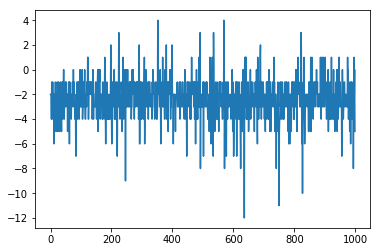

In [8]:
plt.plot(rtrace)
plt.show

In the above experiment, I have used gamma=0.99,alpha=0.1,epsilon=0.0 to train the model and calculates the win rate after testing. I have run this code a lot of times and usually it gives me a win rate of 30% but it can sometimes give slightly random result. We can see that while training, the sum of rewards is negative a lot of times as displayed in the rtrace plot. 

### Selecting best gamma

In the following cell, I am using different values of gamma keeping alpha and epsilon constant at 0.1 to train the model and test it. I have also plotted a line plot at the end where blue colour line is the value of gamma being passed and the orange line represents the win rate at each gamma value. To avoid the browser from crashing I have used a clear_output() function to clear the output after each iteration of for loop.

In [9]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
g = []
w = []
for i in range(11):
    clear_output()
    gamma = i*0.1
    rtrace, Q, rewards = agent.train(start,gamma=gamma,alpha=0.1,epsilon=0.1,maxiter=1000,maxstep=1000)
    g.append(gamma)
    win,loss = agent.test()
    total = win+loss
    Winrate = (win/total)*100
    w.append(Winrate)
    
print("gamma: {}".format(g))
print("Win Rate: {}".format(w))

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 5
Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 4
Current Balance : 12
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 7
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting onl

player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* 

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
Current Balance : 0
player winn

Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 8
player winner
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 2
Current Balance : 31
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 6
player winner
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 2
Curr

Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 7
Current Balance : 36
Current Balance : 36
Current Balance : 36
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 8
player winner
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 10
Current Balance : 20
player loser, wont get back the money, 

Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
pl

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 5
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
Current Balance : 18
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 10
Current Balance : 8
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 9
Draw match
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name

Bet: 5
Current Balance : 33
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 9
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 5
Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
player winner
Current Balance : 19
*-* *-* *-*

player name: Saloni money left: 17
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 3
Draw match

player name: Saloni money left: 6
Bet: 2
Draw match
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *

Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 8
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 6
Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 8
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 7
Current Balance : 18
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 10
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Bet: 9
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 4
Current Balance : 10
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 9
Current Balance : 9
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 2
Current Balance : 25
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 6
Current Balance : 6
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
Current Balance : 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 3
Current Balance : 10
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
Current Balance : 14
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
Current Balance : 10
Current Balance : 10
player loser, wont get back the money, try next round
*-

player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 1
Current Balance : 16
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1

Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Draw match
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
Current Balance : 3
Current Balance : 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Draw match
Current Balance : 1
*-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
Current Balance : 2
Current Balance : 2
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
pl

Bet: 6
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-*

Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
player loser, wont get back the m

Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 6
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 4
Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 5
Current Balance : 24
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 3
Current Balance : 29
Current Balance : 29
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 3
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

player name: Saloni money left: 10
Bet: 5
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
Current Balance : 4
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 0
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser,

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 31
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 8
Current Balance : 23
Current Balance : 23
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 5
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 4
Current Balance : 21
Current 

player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 6
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *

player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 6
Bet: 6
Current Balance : 0
Current Balance : 0
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 6
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 1
Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
player loser, wont get back th

player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 8
Current Balance : 13
Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 4
Current Balance : 25
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 8
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 7
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  29
player name: Saloni money left: 7
Bet amount : 1
Current Balance :  6
player winner
result: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [10, 2, 8], 'player_total_balance': 8, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 1.0, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  30
player name: Saloni money left: 8
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  31
player name: Saloni money left: 7
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  32
player name: Saloni money left: 6
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

<function matplotlib.pyplot.show(*args, **kw)>

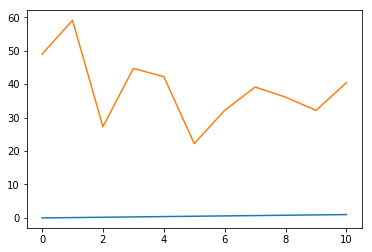

In [10]:
plt.plot(g)
plt.plot(w)
plt.show

#### Effect of gamma parameter

I have recorded the result I received from one of the experiments and the following table shows the results achieved.

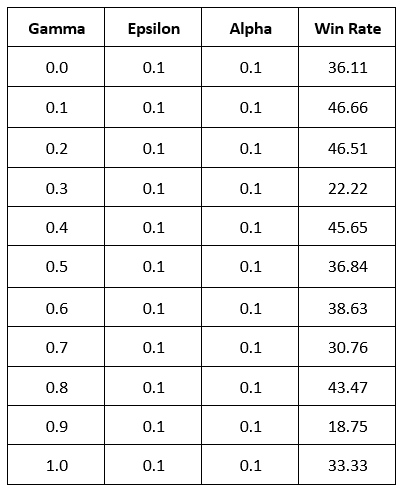

From the table we can see that I am getting maximum win rate when gamma is 0.1 for the selected parameters. Thus using gamma = 0.1 is probably the best path to choose. The plot also displays the win rate against gamma values. Thus, in my opinion, when selecting gamma value, 0.1 is probably a better choice

### Selecting best alpha

In the following cell, I am using different values of alpha keeping gamma and epsilon constant at 0.1 to train the model and test it. I have also plotted a line plot at the end where blue colour line is the value of alpha being passed and the orange line represents the win rate at each alpha value. To avoid the browser from crashing I have used a clear_output() function to clear the output after each iteration of for loop.

In [11]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
al = []
w = []
for i in range(11):
    clear_output()
    alpha = i*0.1
    rtrace, Q, rewards = agent.train(start,gamma=0.1,alpha=alpha,epsilon=0.1,maxiter=1000,maxstep=1000)
    al.append(alpha)
    win,loss = agent.test()
    total = win+loss
    Winrate = (win/total)*100
    w.append(Winrate)
    
print("alpha: {}".format(al))
print("Win Rate: {}".format(w))
    

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player name: Saloni money left: 7
Bet: 6
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
Current Balance : 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
Current Balance : 6
player loser, wont get back the money, try

player name: Saloni money left: 12
Bet: 3
Current Balance : 9
Current Balance : 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player winner
Current Balance : 10
*-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 5
Bet: 4
Current Balance : 1
Current Balance : 1
Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 9
player loser, won

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 3
Current Balance : 8
Current Balance : 8
Current Balance : 8
Draw match
*-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
Current Balance : 6
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9


player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current 

Bet: 7
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-

Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 13
Bet: 10
Current Balance : 3
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 3
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance 

Bet: 2
Draw match
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 6
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 3
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 4
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 6
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 7
player lo

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 6
Current Balance : 6
Current Balance : 6
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 9
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name:

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4


player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of mone

Bet: 6
Current Balance : 3
Current Balance : 3
Current Balance : 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
Current Balance : 3
Current Balance : 3
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
Current Balance : 3
Current Balance : 3
Current Balance : 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *

Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go 

player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
Current Balance : 0
player loser,

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 8
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *

player name: Saloni money left: 5
Bet: 1
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the 

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
Current Balance : 7
Current Balance : 7
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
Current Balance : 8
Current Balance : 8
player winner
*-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 8
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name

Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Draw match
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
p

You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
Current B

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 6
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
player loser, wont get back the money, try n

player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 5
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name

player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
Current Balance : 2

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 10
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 8
Current Balance : 26
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 2
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *

You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
Current Balance : 12
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 10
player loser, wont get back the money, try next round
Current Balance

Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni mo

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
Current Balance : 10
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 3
Current Balance : 19
Current Balance : 19
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 9
Bet: 3
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
Current Balance : 10
Current Balance : 10
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current

Bet: 3
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
Current Balance : 5
Current Balance : 5
Current Balance : 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 3
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
player loser, wont get b

<function matplotlib.pyplot.show(*args, **kw)>

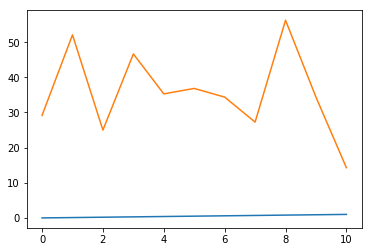

In [12]:
plt.plot(al)
plt.plot(w)
plt.show

#### Effect of alpha parameter

I have recorded the result I received from one of the experiments and the following table shows the results achieved.

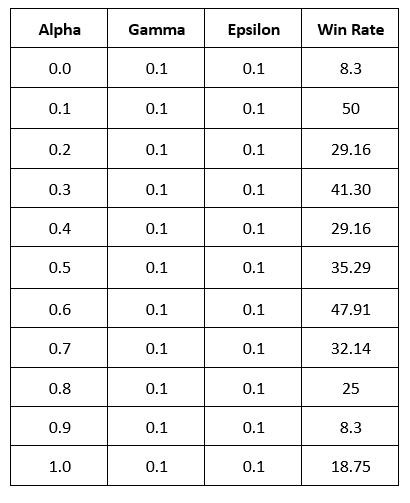

Alpha is the learning rate and from my experience I noticed that it can vary to various values. In this particular experiment, I found that alpha = 0.6 gives the best win rate for the selected parameters. But alpha usually changes and gives variable outputs in my case.


### Selecting best epsilon

In the following cell, I am using different values of epsilon keeping alpha and gamma constant at 0.1 to train the model and test it. I have also plotted a line plot at the end where blue colour line is the value of epsilon being passed and the orange line represents the win rate at each epsilon value. To avoid the browser from crashing I have used a clear_output() function to clear the output after each iteration of for loop.

In [13]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
e = []
w = []
for i in range(11):
    clear_output()
    epsilon = i*0.1
    rtrace, Q, rewards = agent.train(start,gamma=0.1,alpha=0.1,epsilon=epsilon,maxiter=1000,maxstep=1000)
    e.append(epsilon)
    win,loss = agent.test()
    total = win+loss
    Winrate = (win/total)*100
    w.append(Winrate)
    
print("epsilon: {}".format(e))
print("Win Rate: {}".format(w))



*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 1
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 3
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

player name: Saloni money left: 5
Bet: 2
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0

Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Draw match
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
Draw match
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So be

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
Current Balance : 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.


player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next rou

Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-

player name: Saloni money left: 7
Bet: 5
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! W

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 7
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 4
Draw match
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 3
Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 9
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet:

Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 7
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 6
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Bet: 1
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player winner
Current Balance : 9
*-* *-* *-* 

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 2
Current Balance : 16
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1


player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni 

Bet: 7
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 9
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 5
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 9
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 2
*-* 

Bet: 10
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player

Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 10
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 4
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 10
Current Balance : 20
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money

player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next roun

player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Draw match
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont

Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 1
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 9
player winner
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 5
player winner
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of

player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round

player name: Saloni money left: 20
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player winne

player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So bett

player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of mon

player name: Saloni money left: 28
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player winner
Current Balance : 12
*-* *-* *-*

player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 3
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 2
Current

Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni 

You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* 

player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: 

Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 3
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 10
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni 

player name: Saloni money left: 10
Bet: 7
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balan

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Curren

Bet: 4
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 7
Current Balance : 15
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *

<function matplotlib.pyplot.show(*args, **kw)>

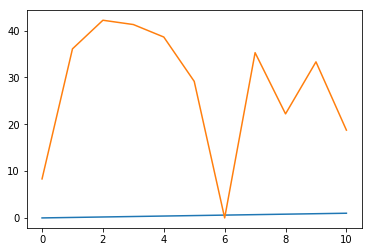

In [14]:
plt.plot(e)
plt.plot(w)
plt.show

#### Effect of epsilon values

I have recorded the result I received from one of the experiments and the following table shows the results achieved.

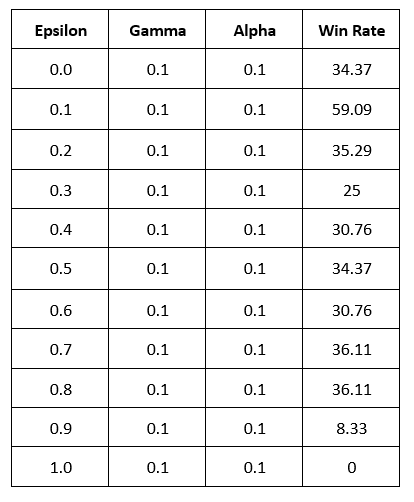

Epsilon in my experiment gave better win rate for epsilon=0.1. And thus I think that using epsilon = 0.1 for this particular combination of values is a better choice as it gives me best win rate.

### Epsilon decaying approach

In [15]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
e = []
w = []
for i in range(11):
    clear_output()
    epsilon = (1.0-(i*0.1))
    rtrace, Q, rewards = agent.train(start,gamma=0.1,alpha=0.1,epsilon=epsilon,maxiter=1000,maxstep=1000)
    e.append(epsilon)
    win,loss = agent.test()
    total = win+loss
    Winrate = (win/total)*100
    w.append(Winrate)
    
print("epsilon: {}".format(e))
print("Win Rate: {}".format(w))



*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Draw match
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 8
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 9
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 7
Current Balance : 16
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 1
Current Balance : 29
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 8
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

player name: Saloni money left: 76
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 70
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 70
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 69
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 69
Bet: 10
Current Balance : 59
Current Balance : 59
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 59
Bet: 9
Current Balance : 50
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 68
Bet: 5
Current Balance : 63
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 73
Bet: 8
player loser, wont get bac

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 9
Draw match
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 3
Current Balance : 33
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 1
Current Balance : 32
Current Balance : 32
Current Balance : 32
Current Balance : 32
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 1
player winner
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player name: Saloni money left: 33
Bet: 7
Current Balance : 26
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 7
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 3
Current Balance : 36
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 9
Current Balance : 27
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 10
Current Balance : 17
player loser, wont get bac

Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 22
Current Balance : 22
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next ga

Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 8
Draw match
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 1
Current Balance : 45
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 5
Current Balance : 35
Current Balance : 35
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 10
Current Balance : 35
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Bet: 5
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
Current Balance : 0
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 9
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 


You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 5
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 3
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 2
Current Balance : 11
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next

Bet: 7
Current Balance : 3
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Draw match
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Bet: 3
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next g

Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 5
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 9
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 10
player winner
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 9
Current Balance : 28
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 7
player loser

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player nam

Bet: 10
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 3
Current Balance : 23
Current Balance : 23
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 5
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *

Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
B

player name: Saloni money left: 47
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 41
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 6
player winner
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 7
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 9
Current Balance : 35
player loser, wont get bac

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
Current Balance : 6
Current Balance : 6
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player loser, wo

Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Draw match
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 3
Current Balance : 18
Current Balance : 18
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 7
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 3
player winner
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 8
player winner
Current Balance

Bet: 4
Current Balance : 64
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 72
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 64
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 64
Bet: 6
Current Balance : 58
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 70
Bet: 9
Current Balance : 61
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 61
Bet: 7
Current Balance : 54
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 10
player winner
Current Balance : 64
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Bet: 4
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 10
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 5
Current Balance : 33
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 7
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 10
player winner
Current Balance : 41
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 10
Current Balance : 31
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 7
Current Balance : 24
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player

Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 10
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 7
Current Balance : 27
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 10
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 8
player winner
Current Balance : 52
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 1
Current Balance : 51
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 5
player loser, wont get back the money, try next r

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 79
Bet: 9
player winner
Current Balance : 88
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 88
Bet: 6
Current Balance : 82
Current Balance : 82
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 94
Bet: 9
Current Balance : 85
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 94
Bet: 5
Current Balance : 89
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 99
Bet: 4
player winner
Current Balance : 103
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 103
Bet: 2
player loser, wont get back the money, try next round
Current Balan

player name: Saloni money left: 75
Bet: 10
Current Balance : 65
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 75
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 70
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 70
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 62
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 60
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 60
Bet: 8
Current Balance : 52
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 60
Bet: 10
Current Balance : 50
player loser, wont get back the

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 8
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 1
Current Balance : 38
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *

Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 7
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

player name: Saloni money left: 7
Bet: 3
Current Balance : 4
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player winner
*-

player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 18
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 

Current Balance : 7
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
Current Balance : 7
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Draw match
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-*

Bet: 5
Current Balance : 39
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 1
Current Balance : 38
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 10
Current Balance : 17
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-*

player name: Saloni money left: 19
Bet: 5
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 2
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 7
Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* 

Bet: 1
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* 

Bet: 8
player winner
Current Balance : 129
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 129
Bet: 6
Current Balance : 123
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 123
Bet: 6
Current Balance : 117
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 117
Bet: 4
player winner
Current Balance : 121
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 121
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 111
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 111
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 

Current Balance : 70
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 70
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 65
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 65
Bet: 8
Current Balance : 57
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 5
Current Balance : 52
Current Balance : 52
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 3
Current Balance : 49
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 48
*-* *-* 

Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 6
Current Balance : 11
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 1
Current Balance : 22
Current Balance : 22
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 6
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 7
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 16
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 7
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 6
Current Balance : 22
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 10
player winner
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 2
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 4
player loser, 

player name: Saloni money left: 4
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-

Bet: 4
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 7
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 6
Current Balance : 27
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 9
Current Balance : 18
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 8
player winner
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 7
Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 81
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 93
Bet: 3
player winner
Current Balance : 96
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 96
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 95
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 95
Bet: 8
player winner
Current Balance : 103
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 103
Bet: 7
Current Balance : 96
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 96
Bet: 7
Current Balance : 89
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name:

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 7
Current Balance : 35
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 5
Current Balance : 30
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 2
player winner
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 10
Draw match
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 4
Current Balance : 33
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 10
Current Bal

player winner
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 4
Draw match
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 6
Draw match
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 7
Current Balance : 42
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 8
Current Balance : 34
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 10
Current Balance : 24
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Bet: 9
Draw match
Current Balance : 41
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 1
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 5
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 5
Current Balance : 42
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 3
Current Balance : 39
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 8
Current Balance : 37
Current Balance : 37
Current Balance : 37
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Bet: 4
player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player loser, wont get back the money, try next

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 4
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 8
Current Balance : 22
Current Balance : 22
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 8
Current Balance : 29
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 9
Current Balance : 28
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 8
Current Balance : 38
Current Balance : 38
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 4
Current Balance : 32
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Bet: 3
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 5
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-*

Bet: 1
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 6
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
Draw match
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
pla

Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 9
Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
Current Balance : 7
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the mo

player name: Saloni money left: 32
Bet: 4
Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 9
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 1
player winner
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 9
player winner
Current Balance : 40
*-* *-* *-* *

player loser, wont get back the money, try next round
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 7
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 7
Current Balance : 40
Current Balance : 40
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 7
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 9
player loser, wont get back the money, try next round
Current Balance

Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 2
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Salon

Current Balance : 0
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
Current Balance :

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 2
Current Balance : 25
Current Balance : 25
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 8
Draw match
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 9
Current Balance : 16
Current Balance : 16
Current Balance : 16
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 2
player winner
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 3
Current Balance : 33
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 6
player winner
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 7
Current Balance : 28
Current Balance : 28
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 2
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 3
Current Balance : 41
Current Balance : 41
pla

player name: Saloni money left: 13
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 4
Current Balance : 7
player w

Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 4
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player winner
Current Balance 

player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 7
player loser, wont get back 

player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 7
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 3
Current Balance : 25
Current Balance : 25
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 10
Current Balance : 21
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 5
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 8
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player n

Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 4
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Current Balance : 4
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 23
Bet: 7
Current Balance : 16
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 7
Current Balance : 23
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 2
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 2
Current Balance : 37
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 3
Current Balance : 29
player loser, wont get back the money, try nex

player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Sal

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 10
Current Balance : 9
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 69
Bet: 2
Current Balance : 67
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 71
Bet: 2
Current Balance : 69
Current Balance : 69
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 73
Bet: 6
Draw match
Current Balance : 73
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 73
Bet: 2
Current Balance : 71
Current Balance : 71
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 75
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 68
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 68
Bet: 1
Current Balance : 67
Current Balance : 67
Current Balance : 67
player loser, wont get bac

player name: Saloni money left: 18
Bet: 5
Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 10
Draw match
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 7
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 9
Current Balance : 15
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 8
Current Balance : 16
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 4
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 5
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 9
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Bet: 9
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
Current Balance : 12
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player loser, wont get back the money, try next round
Current Balan

player name: Saloni money left: 20
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player loser, wo

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 8
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 10
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 7
Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

Current Balance : 9
Current Balance : 9
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
Current Balance : 12
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 2
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 4
Current Balance : 22
Current Balance : 22
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 4
Current Balance : 26
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the mo

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player winner
Current Balance : 9
*-* *-* *-* *-* *

Bet: 10
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
Current Balance : 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 5
Draw match
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*

Bet: 2
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 3
Current Balance : 24
Current Balance : 24
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
Current Balance : 18
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 9
Current Balance : 9
Current Balance : 9
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 10
C

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 6
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 1
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 2
Draw match
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 7
Current Balance : 23
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 7
player winner
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player nam

player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 10
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 7
Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 8
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* 

player name: Saloni money left: 15
Bet: 2
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 1
Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 4
Current Balance : 7
player winner
*-* *-* *-* *

Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 4
player winner
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 6
Current Balance : 41
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *

player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 3
Current Balance : 8
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
Current Balance : 9
Current Balance : 9
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 34
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 8
player winner
Current Balance : 62
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 56
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 56
Bet: 1
Current Balance : 55
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 3
Current Balance : 52
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 44
*-* *-* *-* *-*

<function matplotlib.pyplot.show(*args, **kw)>

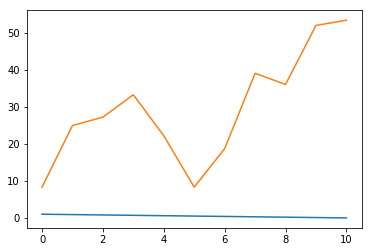

In [16]:
plt.plot(e)
plt.plot(w)
plt.show

I have recorded the result I received from one of the experiments and the following table shows the results achieved.

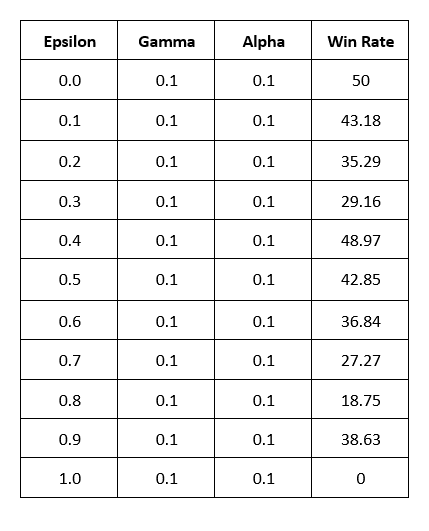

From the result, we can see that when the value of epsilon decreases we get the best win rate. And similar to the experiment I performed before, we can see that the model gives zero win rate for epsilon = 1.0, therefore, we can say that epsilon nearer to zero gives better win rate and thus in my opinion, epsilon=0 gives best win rate.


## Selected Parameters
In this section I will be trying different combinations of parameters that I think would give better results based on the results of the previous section. So from the previous section, I have found that gamma is best at 0.1, alpha at 0.6, and epsilon at 0.0. But now I will be using these deductions to run more experiments.


### gamma=0.99,alpha=0.1,epsilon=0.1

In [17]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.99,alpha=0.1,epsilon=0.1,maxiter=1000,maxstep=1000)
#clear_output()


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni 

Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 2
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
Y

player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
Current Balance : 1
Current Balance : 1
Current Balance : 1
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni mo

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 4
Current Balance : 8
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 1
Current Balance : 16
player loser, wont get back the money, try next round
*-

Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 8
Current Balance : 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Draw match
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10


player name: Saloni money left: 11
Bet: 6
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You c

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Salo

Bet: 2
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 1
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
Draw match
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player l

Bet: 10
Current Balance : 35
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 10
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 6
Current Balance : 19
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 10
Current Balance : 14
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 4
Current Balance : 30
player loser, won

Current Balance : 38
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 9
Current Balance : 35
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 5
Current Balance : 30
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 6
Current Balance : 24
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 1
player loser, wont get back the money, try next ro

Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next

Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Draw match
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
p

player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 2
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Draw match
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

Bet: 10
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 6
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
Draw match
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 4
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 8
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 2
Current Balance : 40
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 9
Current Balance : 31
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 4
player winner
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35


Current Balance : 32
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 48
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 3
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 7
player winner
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 6
player winner
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game

Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*

Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 6
Current Balance : 43
Current Balance : 43
Current Balance : 43
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 1
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 2
Current Balance : 42
Current Balance : 42
Current Balance : 42
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 3
Current Balance : 43
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 16
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 1
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 7
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 6
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 5
Draw match
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 1
Current Balance : 14
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 37
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 53
Bet: 5
Current Balance : 48
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 58
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 3
player winner
Current Balance : 54
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 6
Current Balance : 48
Current Balance : 48
Current Balance : 48
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 60
Bet: 6
Current Balance : 54
Current Balance : 54
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, w

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current B

player name: Saloni money left: 29
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 10
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 8
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 4
Current Balance : 20
player loser, wont get back 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 1
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 1
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 8
player loser, wont get back the money, try n

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 2
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Wi

Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 8
Draw match
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 3
Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 9
Draw match
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 3
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21

player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 6
Current Balance : 2
Current Balance : 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1


In [18]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
player loser, wont get back the money, try next round
result: {'state': {'player_info': {'player_sum_card': 22, 'player_card': [2, 3, 7, 10], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 9
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  2
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
player loser, wont get back the money, try next round
result: {'state': {'player_info': {'player_sum_card': 23, 'player_card': [4, 4, 9, 6], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 10}, 'reward': -1, 'is_round_done': True}
*-*

<function matplotlib.pyplot.show(*args, **kw)>

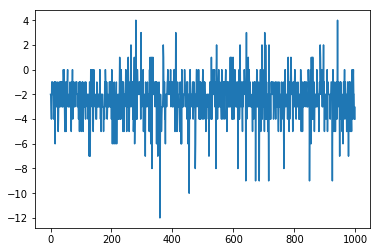

In [19]:
plt.plot(rtrace)
plt.show

In the above cell, I have tried to experiment with the parameter values by passing gamma=0.99, alpha=0.1, epsilon=0.1. Almost everytime I was able to achieve high win rate with these parameters. I did get random values sometimes, but most of the time the win rate was above 40% for me. From the rtrace we can get a plot of the sum of rewards at each episode. We can see that while training, the sum of rewards is negative a lot of times as displayed in the rtrace plot. 


### gamma=0.5,alpha=0.1,epsilon=0.1

In [20]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.5,alpha=0.1,epsilon=0.1,maxiter=1000,maxstep=1000)
#clear_output()

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 8
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
playe

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 5
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 7
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 1
Current Balance : 29
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 9
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
Current Balance : 18
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 10
Current Balance : 7
Current Balance : 7
Current Balance : 7
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* 

player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the mone

player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-*

Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 2
Current Balance : 20
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 8
Current Balance : 16
Current Balance : 16
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 24
Bet: 8
Draw match
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 10
player winner
Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 7
player winner
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 6
Current Balance : 30
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-*

Current Balance : 2
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
Draw match
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
Current Balance : 7
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
Current Balance : 12
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-*

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Draw match
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 6
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 10
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player loser

Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 10
player winner
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 7
Current Balance : 18
player winne

player name: Saloni money left: 10
Bet: 9
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
Current Balance : 18
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
Current Balance : 18
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 6
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 2
Current Balance : 24
Current Balance : 24
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Draw match
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 4
Current Balance : 12
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 1
Current Balance : 15
Curren

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 90
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 86
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 86
Bet: 1
player winner
Current Balance : 87
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 87
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 78
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 78
Bet: 2
player winner
Current Balance : 80
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 80
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 77
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
Current Balance : 9
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
Current Balance : 3
player winner
*-* *-* *-* 

You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-

Bet: 5
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 5
player loser, wont get back the money, try next r

player name: Saloni money left: 24
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
Current Balance : 4
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player winner
*-* *

Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 3
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 9
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 5
Current Balance : 27
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 9
Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 6
Curren

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 96
Bet: 3
Current Balance : 93
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 93
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 85
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 85
Bet: 5
Current Balance : 80
Current Balance : 80
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 90
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 84
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 84
Bet: 4
Current Balance : 80
Current Balance : 80
player loser, wont get back the money, try next 

player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 4
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 7
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Draw match
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 6
Current Balance : 31
Current Balance : 31
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 10
Current Balance : 23
Current Balance : 23
Current Balance : 23
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 4
Current Balance : 39
Curre

Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 8
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 4
Current Balance : 17
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name

Current Balance : 51
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 10
player winner
Current Balance : 61
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 61
Bet: 2
Current Balance : 59
Current Balance : 59
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 63
Bet: 7
Current Balance : 56
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 56
Bet: 7
Current Balance : 49
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 10
Current Balance : 39
Current Balance : 39
Current Balance : 39
play

player name: Saloni money left: 42
Bet: 4
Current Balance : 38
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 6
Current Balance : 40
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 3
Current Balance : 49
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 9
Current Balance : 36
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 6
Current Balance : 30
Current Balance : 30
player winner
*-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 9
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Draw match
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
Current Balance : 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 1
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 3
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 3
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 3
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
player w

Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
Current Balance : 12
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 1
Current Balance : 34
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 3
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 10
player winner
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 8
player winner
Current Balance : 57
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 10
player winner
Current B

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 7
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 5
Current Balance : 8
Current Balance : 8
player loser, wont get back the money, try ne

Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balan

player name: Saloni money left: 10
Bet: 10
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 9
Current Balance : 20
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 7
Current Balance : 22
Current Balance : 22
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 3
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Bet: 1
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* 

Bet: 4
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 9
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player name: Saloni money left: 49
Bet: 4
Current Balance : 45
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 53
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 50
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 50
Bet: 3
Current Balance : 47
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 50
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 5
player winner
Current Balance : 50
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 50
Bet: 9
Current Balance : 41
player loser, wont get back the money, try next round
*-* *-* *-* *-* 

Bet: 4
Current Balance : 18
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 4
Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 10
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 5
Current Balance : 27
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 7
Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 2
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 2
Current Balance : 11
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni mone

player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 10
Draw match
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 3
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 6
Current Balance : 18
Current Balance : 18
Current Balance : 18
player winner
*-* *-* *-* *-*

player name: Saloni money left: 16
Bet: 9
player winner
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 1
Current Balance : 20
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money lef

player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
Current Balance : 11
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game 

You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
Current Balance : 7
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 6
Bet: 3
Current Balance : 3
Current Balance : 3
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 8
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 7
player winner
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 1
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-

In [21]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 11
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  2
player name: Saloni money left: 12
Bet amount : 1
Current Balance :  11
result: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [7, 6, 5, 3], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
Current Balance :  11
player winner
result: {'state': {'player_info': {'player_sum_card': 21, 'player_card': [7, 6, 5, 3], 'player_total_balance': 13, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

<function matplotlib.pyplot.show(*args, **kw)>

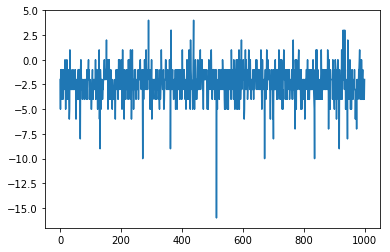

In [22]:
plt.plot(rtrace)
plt.show

In the above cell, I have used gamma=0.5, alpha=0.1, epsilon=0.1. This combination of parameters have given me excellent win rate of 48% in most cases. My results comes out to be slightly random but maximum times I get higher win rate. We can see that while training, the sum of rewards is negative a lot of times as displayed in the rtrace plot. 


### gamma=0.6,alpha=0.2,epsilon=0.0

In [23]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.5,alpha=0.2,epsilon=0.0,maxiter=1000,maxstep=1000)
#clear_output()

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 9
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Draw match
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 2
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 10
player winner
Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 4
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 7
player

Current Balance : 25
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 1
Draw match
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 10
Current Balance : 17
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 7
Current Balance : 30
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 1
Current Balance : 43
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 5
player loser,

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Draw match
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Draw match
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
player winner
Current B

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 7
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player winner
Current Balance : 13
*-* *-* *-* 

Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 8
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
player loser, wont get back the money, try next round

Current Balance : 36
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 9
Current Balance : 35
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 1
Current Balance : 34
Current Balance : 34
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 9
player winner
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 8
Current Balance : 27
Current Balance : 27
Current Balance : 27
player loser, wont get back the money, try ne

Bet: 5
Current Balance : 37
Current Balance : 37
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 6
Current Balance : 41
Current Balance : 41
Current Balance : 41
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 53
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 3
Current Balance : 48
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 5
player loser, wont get back the money, try next round
Curre

Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 2
Current Balance : 26
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 2
Current Balance : 28
Current Balance : 28
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 1
Current Balance : 31
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 8
Current Balance : 25
Current Balance : 25
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 8
Current Balance : 33
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 6
player win

player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 3
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 3
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 3
Current Balance : 8
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 

player name: Saloni money left: 26
Bet: 2
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 5
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 4
Current Balance : 19
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 6
Current Balance : 13
Current Balance : 13
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
Curre

Bet: 1
player loser, wont get back the money, try next round
Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 10
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 8
Current Balance : 31
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 10
Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 1
Current Balance : 40
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 6
Current Balance : 34
Current Balance : 34
player loser, wont get back the money, 

Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 9
player winner
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 41
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 2
Current Balance : 39
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 9
Current Balance : 34
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 10
Current Balance : 24
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 5
Current Balance : 47
Current Balance : 47
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 10
Current Balance : 47
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 67
Bet: 5
Current Balance : 62
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 10
Draw match
Current Balance : 62
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 58
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Sa

Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-*

Bet: 7
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 4
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 8
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 4
Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 2
Current Balance : 20
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-*

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 8
Current Balance : 7
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 10
Bet: 4
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 7
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 3
Current Balance : 18
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 14
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Current Balance : 4
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balan

player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19

Bet: 10
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 1
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 8
Current Balance : 15
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 5
Current Balance : 26
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 12
Bet: 6
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 1
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player winner
*-* *-* *-* *-* *

Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balanc

player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 5
Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 54
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 4
Current Balance : 50
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 50
Bet: 6
Current Balance : 44
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 9
Current Balance : 35
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 53
Bet: 2
Current Balance : 51
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 10
Draw match
Current Balance : 51
*-* *-* *-* *-* *

Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 9
Draw match
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 10

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 5
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 2
player winner
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 4
Current Balance : 42
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

Bet: 6
Draw match
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 1
Draw match
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
Current Balance : 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 7
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 10
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 5
Bet: 5
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can onl

Bet: 3
Current Balance : 4
Current Balance : 4
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 4
Current Balance : 14
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
Current Balance : 6
playe

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 1
Current Balance : 27
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 7
Current Balance : 20
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
Current Balance : 8
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 3
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 12
Bet: 2
Current Balance : 10
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 1
Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Draw match
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-

Bet: 5
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 6
Current Balance : 27
Current Balance : 27
Current Balance : 27
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 4
C

Current Balance : 48
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 1
Current Balance : 53
Current Balance : 53
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 4
Current Balance : 51
Current Balance : 51
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 6
Current Balance : 49
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 10
Current Balance : 33
player loser, wont get back the money, try next round
*-* *-* *-* *-*

Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 10
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
Current Balance : 1
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
play

Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Current Balance : 4
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 17
Bet: 8
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 6
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the

Bet: 4
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 1
Current Balance : 17
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 8
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player n

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 


In [24]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
player winner
result: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [5, 5, 10], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 3}, 'reward': 1.0, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 11
Bet amount : 1
Current Balance :  10
result: {'state': {'player_info': {'player_sum_card': 15, 'player_card': [2, 8, 4, 1], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
Current Balance :  10
result: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [2, 8, 4, 1, 5], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 0, 'is_round_done': False}
Current Balance :  10
player winner
resu

<function matplotlib.pyplot.show(*args, **kw)>

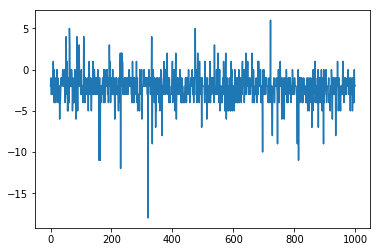

In [25]:
plt.plot(rtrace)
plt.show

In the above cell, I have used gamma=0.5, alpha=0.2, epsilon=0.0. This combination of parameters has given the least win rate of around 18% in maximum attempts. Thus, this is definitely not a good parameter choice.  We can see that while training, the sum of rewards is negative a lot of times as displayed in the rtrace plot. 

### gamma=0.99,alpha=0.5,epsilon=0.9

In [26]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.99,alpha=0.5,epsilon=0.9,maxiter=1000,maxstep=1000)
#clear_output()

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 4
Current Balance : 24
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 9
Current Balance : 23
player winner
*-* *-* *-* *-

player name: Saloni money left: 29
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 10
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 1
Current Balance : 33
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 5
player 

player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* 

player name: Saloni money left: 7
Bet: 5
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-*

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 8
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 5
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player n

player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 4
Draw match
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 7
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 9
Draw match
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner


Bet: 4
Current Balance : 6
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
Draw match
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Bet: 1
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player 

player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
Current Balance : 1
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 2
Current Balance : 21
Current Balance : 21
Current Balance : 21
Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 6
Draw match
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni mone

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name:

player name: Saloni money left: 10
Bet: 7
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 5
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 1
Current Balance : 19
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
player winner
Current Balance : 12
*-* *-* *-* *

player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. S

player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are 

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
Current Balance : 8
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 8
Current Balance : 19
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 10
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 4
Current Balance : 20
player loser, wont get back 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 6
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *

You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Draw match
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 10
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

In [27]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 9
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  2
player name: Saloni money left: 8
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  3
player name: Saloni money left: 7
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  4
player name: Saloni money left: 8
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *

<function matplotlib.pyplot.show(*args, **kw)>

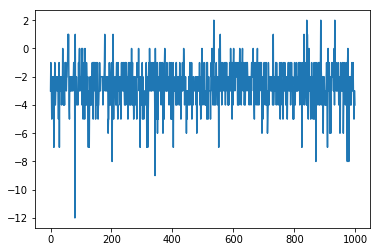

In [28]:
plt.plot(rtrace)
plt.show

In the above cell, I have used gamma=0.99, alpha=0.5, epsilon=0.9. This combination of parameters has given a very low win rate of around 22%. Also from the plots it can be seen that the agent is getting too many negative rewards as well. So, this means that this combination of parameters should not be used for training the model. We can see that while training, the sum of rewards is negative a lot of times as displayed in the rtrace plot. 


### gamma=0.0,alpha=0.2,epsilon=0.1

In [29]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.0,alpha=0.2,epsilon=0.1,maxiter=1000,maxstep=1000)
#clear_output()

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 2
Current Balance : 11
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
player winner
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 3
player loser, wont get back the money, try next ro

player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*

Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 2
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Bet: 2
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 2
player winner
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 8
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player loser, wont get back the money, try nex

Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 6
player winner
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 4
Draw match
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Bala

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money l

player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 52
Bet: 3
Current Balance : 49
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 3
player winner
Current Balance : 52
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 1
player winner
Current Balance : 53
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 53
Bet: 2
Current Balance : 51
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 7
player winner
Current Balance : 62
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 9
Current Balance : 53
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Bet: 4
player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 9
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 1
Current Balance : 17
player loser, wont get

Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* 

You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 3
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 9
Current Balance : 8
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
Current Balance : 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-

player name: Saloni money left: 20
Bet: 2
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
player winner
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 8
player winner
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *

Bet: 8
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* 

player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 6
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 1
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

Bet: 7
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 5
Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 2
player loser, wont get back the money, try

Bet: 10
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 2
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 9
Current Balance : 35
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 8
player winner
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 7
Current Balance : 36
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 50
Bet: 10
Current Balance : 40
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 60
Bet: 1
pla

Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 5
player winner
Current Balance : 44
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 7
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 8
Current Balance : 39
Current Balance : 39
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player 

Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 7
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
Current Balance : 18
Current Balance : 18
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 8
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 6
player winner
Current Balance : 14
*-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 109
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 108
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 108
Bet: 7
Draw match
Current Balance : 108
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 108
Bet: 9
Current Balance : 99
Current Balance : 99
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 108
Bet: 3
Current Balance : 105
Current Balance : 105
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 105
Bet: 5
Current Balance : 100
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
pla

Draw match
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 8
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 7
Current Balance : 19
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
player winner
Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 8
pl

Bet: 3
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 1
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 10
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 10
Current Balance : 19
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 9
Draw match
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

player name: Saloni money left: 15
Bet: 1
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
player winner
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 3
Current Balance : 22
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 5
Current Balance : 7
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 50
Bet: 2
Current Balance : 48
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 48
Bet: 4
Current Balance : 44
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 8
Current Balance : 38
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 8
player winner
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player na

player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 5
Current Balance : 2
Current Balance : 2
player winner

player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *

player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
Current Balance : 12
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 1
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back th

Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 1
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 7
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 67
Bet: 2
Draw match
Current Balance : 67
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 67
Bet: 7
Current Balance : 60
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 74
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 69
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 69
Bet: 2
Draw match
Current Balance : 69
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 69
Bet: 3
player winner
Current Balance : 72
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 72
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 70
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Bet: 6
player winner
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 1
player winner
Current Balance : 52
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 9
Current Balance : 43
Current Balance : 43
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 61
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 57
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 8
player winner
Current Balance : 65
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 65
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 62
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 25
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 9
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 25
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 10
player winner
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 1
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player loser, wont get back the money, try next round
Curr

player name: Saloni money left: 29
Bet: 9
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 2
Current Balance : 36
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 10
player winner
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 1
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 4
player winner
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 51
Bet: 10
player winner
Current Balance : 61
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player nam

Bet: 6
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 7
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 7
Current Balance : 21
Current Balance : 21
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 19
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 7
player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player lose

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 3
player winner
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player

Bet: 10
player winner
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 2
Current Balance : 33
Current Balance : 33
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 2
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 5
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 3
Current Balance : 17
player loser, wont get back the money, try next round
*-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
Current Balance : 18
Current Balance : 18
Current Balance : 18
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 4
player winner
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 8
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 3
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 3
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Bet: 1
Draw match
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 3
player winner
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 7
Current Balance : 5
Current Balance : 5
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 10
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 25
Bet: 

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 10
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-

player name: Saloni money left: 9
Bet: 8
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 9
player winner
Current Balance : 29
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 6
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-

player name: Saloni money left: 5
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
Current Balance : 2
player winner
*-* *-* *-* *-* *-

player name: Saloni money left: 56
Bet: 10
Current Balance : 46
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 66
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 62
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 7
Current Balance : 55
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 9
Current Balance : 36
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 10
player winner
Current Balance : 64
*-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
Current Balance : 5
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player winner
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
B

player name: Saloni money left: 21
Bet: 9
player winner
Current Balance : 30
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 7
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 5
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 5
player lo

Bet: 4
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!


In [30]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
result: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 1, 3, 3], 'player_total_balance': 9, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0, 'is_round_done': False}
Current Balance :  9
Draw match
result: {'state': {'player_info': {'player_sum_card': 17, 'player_card': [10, 1, 3, 3], 'player_total_balance': 10, 'usable_ace': False}, 'dealer_info': 7}, 'reward': 0.0, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 10
Bet amount : 1
Current Balance :  9
player winner
result: {'state': {'player_info': {'player_sum_card': 20, 'player_card': [4, 8, 8], 'player_total_balance': 11, 'usable_ace': False}, 'dealer_info': 10}, 'reward': 1.0, 'is_round_done': True}
*-* *-* *-* *-* *-* *-* *-* *-* *-

<function matplotlib.pyplot.show(*args, **kw)>

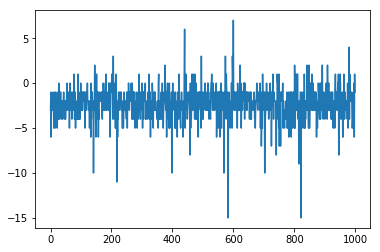

In [31]:
plt.plot(rtrace)
plt.show

In the above cell, I have used gamma=0.0, alpha=0.2, epsilon=0.1. This combination of parameters has given me a very decent win rate of around 42% and this this combination of parameters seems to be a good choice to be used for training the agent. We can see that while training, the sum of rewards is negative a lot of times as displayed in the rtrace plot. 

#### Best parameters found

In [58]:
env=BlackjackEnv()
agent = RLAgent(env)
start = [0,0]
rtrace, Q, rewards = agent.train(start,gamma=0.1,alpha=0.1,epsilon=0.0,maxiter=1000,maxstep=1000)
#clear_output()

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
Current Balance : 9
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 


player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 3
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 4
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 2
Current Balance : 9
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 55
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 75
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 69
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 69
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 67
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 67
Bet: 1
player winner
Current Balance : 68
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 68
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 60
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 60
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 52
*-* *-* *-* *-*

Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 1
player winner
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
Current Balance : 4
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 4
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
player loser

player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 4
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-

Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player winner
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-

Bet: 9
Current Balance : 9
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 3
Current Balance : 20
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 5
Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 5
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 10
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player 

player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 7
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 2
Current Balance : 16
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 10
player winner
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 2
Draw match
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 2
Current Balance : 36
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 35
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 35
Bet: 5
player winner
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player winner
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 1
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-*

player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
player winner
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 1
Current Balance : 17
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 5
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 10
Current Balance : 13
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left

player winner
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 7
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
player winner
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
Current Balance : 18
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 4
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 6
Current Balance : 14
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 8
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 6
player loser, wont get back the money, try next 

Bet: 7
player loser, wont get back the money, try next round
Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 2
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 2
Draw match
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 10
Current Balance : 4
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Sal

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 66
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 57
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 3
Current Balance : 54
Current Balance : 54
Current Balance : 54
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 60
Bet: 5
Current Balance : 55
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 55
Bet: 7
Current Balance : 48
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 62
Bet: 2
player winner
Current Balance : 64
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 9
Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 2
Current Balance : 14
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 8
Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
Current Balance : 5
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 1
Current Balance : 5
player loser, wont get

Current Balance : 93
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 93
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 91
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 91
Bet: 10
player winner
Current Balance : 101
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 101
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 95
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 95
Bet: 10
Current Balance : 85
Current Balance : 85
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 105
Bet: 7
Current Balance : 98
Current Balance : 98
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 8
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 4
Curren

player loser, wont get back the money, try next round
Current Balance : 28
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 22
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 22
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 9
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 7
Current Balance : 16
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 9
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 88
Bet: 3
Draw match
Current Balance : 88
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 88
Bet: 7
player winner
Current Balance : 95
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 95
Bet: 6
Current Balance : 89
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 89
Bet: 9
Current Balance : 80
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 98
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 88
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 88
Be

player name: Saloni money left: 10
Bet: 6
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 1
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 7
Current Balance : 10
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

player name: Saloni money left: 27
Bet: 7
player winner
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 10
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 4
Current Balance : 38
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 4
Current Balance : 34
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 8
player winner
Current Bala

player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
player winner
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player name: Saloni money left: 10
Bet: 1
Current Balance : 9
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
player winner
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 9
Current Balance : 2
Current Balance : 2
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 8
Current Balance : 12
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player winner
*-* *-* *-* *-* *-*

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 5
Current Balance : 33
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 10
player winner
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 6
Current Balance : 37
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 8
player winner
Current Balance : 57
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 10
Current Balance : 47
player winner
*-* *-* *

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 8
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 24
Current Balance : 24
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 3
Current Balance : 41
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 1
Current Balance : 46
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 48
Bet: 2
Current Balance : 46
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 2
Current Balance : 44
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 44
Bet: 7
player winner
Current Balance : 51
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 41
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 7
Draw match
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 5
player winner
Current Balance : 42
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 42
Bet: 10
player winner
Current Balance : 52
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 52
Bet: 6
Current Balance : 46
Current Balance : 46
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left

player name: Saloni money left: 12
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 9
Current Balance : 0
Current Balance : 0
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 2
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 7
Current Balanc

Bet: 8
Current Balance : 6
Current Balance : 6
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
Current Balance : 3
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 3
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balanc

Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 2
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
player winner
Current Balance : 20
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 4
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-*

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 2
Current Balance : 4
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player winner
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-

player name: Saloni money left: 16
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 15
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 6
Current Balance : 9
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 4
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 1
Current Balance : 12
Current Balance : 12
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 8
player loser, wont get back the 

player name: Saloni money left: 119
Bet: 9
player winner
Current Balance : 128
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 128
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 127
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 127
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 124
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 124
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 121
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 121
Bet: 2
Current Balance : 119
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 119
Bet:

Current Balance : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 4
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 9
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 9
Bet: 1
Current Balance : 8
Current Balance : 8
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
Current Balance : 7
Draw match
*-* 

player name: Saloni money left: 43
Bet: 7
Current Balance : 36
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 3
Current Balance : 33
Current Balance : 33
Current Balance : 33
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 1
Current Balance : 38
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 9
Current Balance : 30
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 48
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 40
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 40
Bet: 9
Current Balance : 31
player winner
*-* *-* *-* *-

Current Balance : 67
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 67
Bet: 10
Current Balance : 57
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 57
Bet: 1
player winner
Current Balance : 58
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 58
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 48
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 48
Bet: 1
player winner
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 3
Current Balance : 46
Current Balance : 46
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-*

player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 5
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser

player winner
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 5
Current Balance : 19
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 7
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 24
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 2
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 5
Current Balance : 21
Current Balance : 21
Current Balance : 21
Current Balance : 21
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Draw match
Current Balance : 10
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
Current Balance : 6
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 10
*-* *-* *-* *-* *-*

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 0
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 8
player winner
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 3
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 7
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player name: Saloni money left: 3
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 3
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 1
Current Balance : 7
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 7
Current Balance : 0
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 12
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 6
Current Balance : 6
player loser, wont get back t

player name: Saloni money left: 32
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 7
Current Balance : 20
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 5
Current Balance : 29
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 10
player winner
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 5
Current Balance : 34
Current Balance : 34
Current Balance : 34
Current Balance : 34
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money 

Bet: 8
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 6
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 6
Current Balance : 12
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 12
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-

player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 7
Current Balance : 29
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 37
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 37
Bet: 10
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 8
Current Balance : 19
Current Balance : 19
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 8
player loser, wont get back the money, try next round
Current Balance :

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 10
player winner
Current Balance : 33
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 33
Bet: 5
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 4
Current Balance : 30
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 9
Current Balance : 29
Current Balance : 29
Current Balance : 29
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 4
Current Balance : 16
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 2
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 18
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 18
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 14
*-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 8
Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 7
player winner
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 27
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 27
Bet: 4
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *

player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 5
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 4
Current Balance : 0
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
Current Balance : 2
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
Current Balance : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 1
You can only bet 1. So betting only 1.
Bet: 1
Current Balance : 0
player loser, wont get back the money, try next round
*-* *-* *-

Bet: 4
Current Balance : 13
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 6
Current Balance : 7
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 9
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 7
Current Balance : 21
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 3
Current Balance : 18
Current Balance : 18
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 24
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-*

player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 5
Current Balance : 5
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 5
Current Balance : 10
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 1
player winner
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 4
Draw match
Current Balance : 16
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

player name: Saloni money left: 10
Bet: 9
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 17
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 17
Bet: 3
Current Balance : 14
Current Balance : 14
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 14
Bet: 6
Current Balance : 8
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 20
Bet: 5
Current Balance : 15
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 15
Bet: 4
Current Balance : 11
player 

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 3
player winner
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 6
Current Balance : 20
Current Balance : 20
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 6
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 8
player loser, wont get back the money, try next round
Current Balance : 26
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money le

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 4
Current Balance : 28
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 28
Bet: 2
Current Balance : 26
Current Balance : 26
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 30
Bet: 4
Current Balance : 26
Current Balance : 26
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 26
Bet: 3
Current Balance : 23
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 21
*-* *-* 

player loser, wont get back the money, try next round
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 1
player winner
Current Balance : 32
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 32
Bet: 6
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 5
player winner
Current Balance : 43
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 43
Bet: 4
Current Balance : 39
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 47
Bet: 5
Current Balance : 42
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: S

*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 0
You are out of money ! Will go to next game !!
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 10
Bet: 9
player winner
Current Balance : 19
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 6
Current Balance : 13
Current Balance : 13
Current Balance : 13
Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 4
player winner
Current Balance : 23
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 23
Bet: 8
Current Balance : 15
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 5
player winner
Current Balance : 36
*-* *-* *

Current Balance : 7
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 7
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 6
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 6
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 2
player winner
Current Balance : 4
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 4
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 2
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 2
Bet: 1
player loser, wont get back the money, try next round
Current Balance : 1
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 

Current Balance : 21
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 31
Bet: 10
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 8
Current Balance : 13
Current Balance : 13
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 29
Bet: 8
Current Balance : 21
Current Balance : 21
Current Balance : 21
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 21
Bet: 5
Current Balance : 16
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 16
Bet: 6
player loser, wont get bac

Draw match
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 48
Bet: 6
Current Balance : 42
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 54
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 9
player loser, wont get back the money, try next round
Current Balance : 36
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 36
Bet: 2
player loser, wont get back the money, try next round
Current Balance : 34
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 34
Bet: 3
player loser, wont get back the money, try next round
Current Balance : 31
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-*

Current Balance : 11
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 11
Bet: 8
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 19
Bet: 6
player loser, wont get back the money, try next round
Current Balance : 13
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 5
player loser, wont get back the money, try next round
Current Balance : 8
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 8
Bet: 5
Current Balance : 3
Current Balance : 3
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 13
Bet: 8
Current Balance : 5
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: 

Bet: 2
player winner
Current Balance : 38
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 38
Bet: 8
player winner
Current Balance : 46
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 46
Bet: 7
player loser, wont get back the money, try next round
Current Balance : 39
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 39
Bet: 10
player winner
Current Balance : 49
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 49
Bet: 4
player loser, wont get back the money, try next round
Current Balance : 45
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player name: Saloni money left: 45
Bet: 2
player winner
Current Balance : 47
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
player

In [61]:
win,loss = agent.test()
total = win+loss
Winrate = (win/total)*100
print("Win Rate" + str(Winrate))


*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  0
player name: Saloni money left: 10
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  1
player name: Saloni money left: 11
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  2
player name: Saloni money left: 10
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  3
player name: Saloni money left: 11
Bet amount : 1
player winner
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  4
player name: Saloni money left: 12
Bet amount : 1
player loser, wont get back the money, try next round
*-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* *-* 
Round Number :  5
player

<function matplotlib.pyplot.show(*args, **kw)>

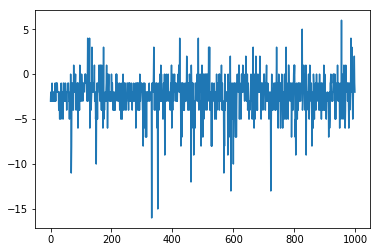

In [62]:
plt.plot(rtrace)
plt.show

In the above cell, I have used gamma=0.1, alpha=0.1, epsilon=0.0. This combination of parameters has given me an excelent win rate of 56% which has been my best till now. Thus, these are the parameters that I have come up with after all the experiments of using different parameters. These parameters are best to be used for training my agent.


## Conclusion

For this assignment we were asked to use reinforcement learning to design an RLAgent to play the game Blackjack. We were provided with the environment already and using the environment we were asked to design the agent. I have used the Q-learning approach for this assignment. I have used Q-learning so that my agent explores all the possible paths. Thus, we will get the best optimum result when we use Q-learning. This assignment gave me knowledge about reinforcement learning because to work on this assignment I had to study a lot. This helped me enhance my knowledge of machine learning algorithms as well. Then once I have come up with my RLAgent, I have run a number of experiments to show what I achieve from different experiments. Since, my bot is not 100% perfect it does give random results sometimes but I have listed the results I received most number of times. There is a scope of improvement in my bot for sure where we can build an intelligent agent whih bets based on prior learning in order to win the game. Since I am using random bets, it can be improved by building a bot. This was an extremely challenging assignment but it helped me learn a lot about machine learning. 

## References

Matplotlib: Python Plotting — Matplotlib 3.0.2 Documentation. https://matplotlib.org/. Accessed 30 Jan. 2019.

Python Data Analysis Library — Pandas: Python Data Analysis Library. https://pandas.pydata.org/. Accessed 30 Jan. 2019.

NumPy — NumPy. http://www.numpy.org/. Accessed 12 Feb. 2019.

https://nbviewer.jupyter.org/url/webpages.uncc.edu/mlee173/teach/itcs6156/notebooks/notes/Note-ReinforcementLearning.ipynb

https://nbviewer.jupyter.org/url/webpages.uncc.edu/mlee173/teach/itcs6156/notebooks/notes/Note-NN%20for%20RL.ipynb

https://curiouscoder.space/blog/machine%20learning/teaching-a-computer-blackjack-using-reinforcement-learning/

https://medium.com/deep-math-machine-learning-ai/ch-12-1-model-free-reinforcement-learning-algorithms-monte-carlo-sarsa-q-learning-65267cb8d1b4

https://en.wikipedia.org/wiki/Q-learning

https://en.wikipedia.org/wiki/Temporal_difference_learning

https://en.wikipedia.org/wiki/State%E2%80%93action%E2%80%93reward%E2%80%93state%E2%80%93action

http://mi.eng.cam.ac.uk/~mg436/LectureSlides/MLSALT7/L3.pdf
